# Install packages

In [ ]:
!python -m pip install pyyaml
import sys, os, distutils.core

# Install detectron2
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

# Import packages

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
torch:  2.6 ; cuda:  cu124
detectron2: 0.6


In [ ]:
# Andre pakker

# Some basic setup:
# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
import pandas as pd

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

import os
import cv2
from detectron2.data import DatasetCatalog, MetadataCatalog
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.datasets import convert_to_coco_json
import shutil
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Load images from GitHub

In [ ]:
from getpass import getpass
import subprocess

# Get GitHub token
token = getpass("Enter your GitHub token: ")

# Define repository URL
repo_url = f"https://{token}@github.com/casperbak1/Dataprojekt.git"

# Kloner main branch, og kun seneste commit (depth 1)
subprocess.run(["git", "clone", "--branch", "main", "--depth", "1", repo_url])

repo_path = "Dataprojekt"
if os.path.exists(repo_path):  # Hvis der findes en GitHub sti "Dataprojekt"
    subprocess.run(["git", "sparse-checkout", "init", "--cone"], cwd=repo_path) # Så klon mappen "Data/Clean Data/Overbite Data"
    subprocess.run(["git", "sparse-checkout", "set", "Data/Clean Data/Overbite Data"], cwd=repo_path)

print("Repository cloned with only the 'Overbite Data' folder.")

Enter your GitHub token: ··········
Repository cloned with only the 'Overbite Data' folder.


# Initialise the data for the model

In [ ]:
# Load the annotations from the CSV file
ANNOTATIONS_FILE = "Dataprojekt/Data/Clean Data/Overbite Data/Updated_Labels.csv"
annotations_df = pd.read_csv(ANNOTATIONS_FILE)

# Sti til dataen
DATASET_PATH = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Data Pairs"

def my_dataset_function():
    dataset_dicts = []

    # Group annotations by filename (in case multiple keypoints exist for an image)
    grouped_annotations = annotations_df.groupby("Filename")

    for idx, filename in enumerate(os.listdir(DATASET_PATH)):
        if filename.endswith((".jpg", ".png", ".jpeg")):
            record = {}
            file_path = os.path.join(DATASET_PATH, filename)

            # Read image dimensions
            height, width = cv2.imread(file_path).shape[:2]

            # Initialize the dataset record
            record["file_name"] = file_path
            record["image_id"] = idx
            record["height"] = height
            record["width"] = width

            # Default empty annotation list
            record["annotations"] = []

            # Check if the file has keypoint annotations
            if filename in grouped_annotations.groups:
                keypoints_list = []
                for _, row in grouped_annotations.get_group(filename).iterrows():
                    x, y = row["X"], row["Y"]
                    keypoints_list.append(x)  # X-coordinate
                    keypoints_list.append(y)  # Y-coordinate
                    keypoints_list.append(2)  # Visibility flag (0=not visible, 1=occluded, 2=visible)

                # Create the annotation entry
                annotation = {
                    "bbox": [0, 0, width, height],  # Dummy bbox covering entire image
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "category_id": 0,  # If you have multiple classes (Vi har 1)
                    "keypoints": keypoints_list,
                    "num_keypoints": len(keypoints_list) // 3
                }
                record["annotations"].append(annotation)

            dataset_dicts.append(record)

    return dataset_dicts

# Register the dataset
DatasetCatalog.register("Overbite_Data", my_dataset_function)
MetadataCatalog.get("Overbite_Data").set(
    thing_classes=["Tooth"],  # Modify for actual class names (Mangler godt navn)
    keypoint_names=["Tooth_KP"],  # Name of keypoints (Mangler endnu bedre navn)
    keypoint_flip_map=[]  # Add keypoint flip pairs if needed (Nope)
)

# Test if it works
dataset_dicts = DatasetCatalog.get("Overbite_Data")
print(f"Loaded {len(dataset_dicts)} images with keypoints.")

Loaded 1585 images with keypoints.


# Initialise validation dataset

In [ ]:
# Funktion til at hente verifikationsdata
def my_validation_function():
    dataset_dicts = []
    DATASET_PATH = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Verication data"

    grouped_annotations = annotations_df.groupby("Filename")

    for idx, filename in enumerate(os.listdir(DATASET_PATH)):
        if filename.endswith((".jpg", ".png", ".jpeg")):
            record = {}
            file_path = os.path.join(DATASET_PATH, filename)
            height, width = cv2.imread(file_path).shape[:2]

            record["file_name"] = file_path
            record["image_id"] = idx
            record["height"] = height
            record["width"] = width
            record["annotations"] = []

            if filename in grouped_annotations.groups:
                keypoints_list = []
                for _, row in grouped_annotations.get_group(filename).iterrows():
                    x, y = row["X"], row["Y"]
                    keypoints_list.append(x)
                    keypoints_list.append(y)
                    keypoints_list.append(2)  # Visibility flag

                annotation = {
                    "bbox": [0, 0, width, height],  # Dummy bbox
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "category_id": 0,
                    "keypoints": keypoints_list,
                    "num_keypoints": len(keypoints_list) // 3
                }
                record["annotations"].append(annotation)

            dataset_dicts.append(record)

    return dataset_dicts

# Registrér valideringsdatasæt
DatasetCatalog.register("Overbite_Validation", my_validation_function)
MetadataCatalog.get("Overbite_Validation").set(
    thing_classes=["Tooth"],
    keypoint_names=["Tooth_KP"],
    keypoint_flip_map=[]
)

namespace(name='Overbite_Validation',
          thing_classes=['Tooth'],
          keypoint_names=['Tooth_KP'],
          keypoint_flip_map=[])

# Train the model

In [ ]:
import os
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
from detectron2.data.datasets import convert_to_coco_json

# Create the configuration
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml"))  # Load Keypoint-RCNN config
cfg.DATASETS.TRAIN = ("Overbite_Data",)  # Training dataset
cfg.DATASETS.TEST = ("Overbite_Validation",)  # Validation dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml")  # Pretrained weights
cfg.SOLVER.IMS_PER_BATCH = 2  # Batch size (Antal billeder per batch) (Større skulle gerne give god træning, men vi har begrænset GPU i "Colab")
cfg.SOLVER.BASE_LR = 0.00025  # Learning rate
cfg.SOLVER.MAX_ITER = 50000  # Antal træningsiterationer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128  # Antal "Regions Of Interest" per billede
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # Antal klasser
cfg.MODEL.KEYPOINT_ON = True  # Enable keypoint detection
cfg.MODEL.ROI_KEYPOINT_HEAD.NUM_KEYPOINTS = 1  # Antal keypoints


cfg.TEST.KEYPOINT_OKS_SIGMAS = [0.1] # Set OKS sigma for 1 keypoint (Default is 17 for COCO)

# Automatisk validering hver 500. iteration
cfg.TEST.EVAL_PERIOD = 500

# Gem automatisk hver 500. iteration
cfg.SOLVER.CHECKPOINT_PERIOD = 500  # Save every 500 iterations

# Output directory for modellen
cfg.OUTPUT_DIR = "./output/Overbite_Model"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Konverter valideringsettet til COCO JSON format
coco_annotation_path = os.path.join(cfg.OUTPUT_DIR, "Overbite_Validation_coco_format.json")
convert_to_coco_json("Overbite_Validation", coco_annotation_path)
print(f"Validation set converted to COCO format: {coco_annotation_path}")

# Inkluder evaluatoren
class TrainerWithEval(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name):
        return COCOEvaluator(dataset_name, cfg, False, output_dir=cfg.OUTPUT_DIR)

# Træn modellen med evaluering
trainer = TrainerWithEval(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

# Kør en sidste evaluering på valideringsdataen
val_loader = build_detection_test_loader(cfg, "Overbite_Validation")
inference_on_dataset(trainer.model, val_loader, COCOEvaluator("Overbite_Validation", cfg, False, output_dir=cfg.OUTPUT_DIR))

print("Training and validation completed!")

[05/07 12:58:49 d2.data.datasets.coco]: Converting annotations of dataset 'Overbite_Validation' to COCO format ...)
[05/07 12:58:51 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[05/07 12:58:51 d2.data.datasets.coco]: Conversion finished, #images: 100, #annotations: 100
[05/07 12:58:51 d2.data.datasets.coco]: Caching COCO format annotations at './output/Overbite_Model/Overbite_Validation_coco_format.json' ...
Validation set converted to COCO format: ./output/Overbite_Model/Overbite_Validation_coco_format.json
[05/07 12:58:52 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1

roi_heads.keypoint_head.score_lowres.{bias, weight}


[05/07 12:59:13 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/detectron2/structures/keypoints.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  keypoints = torch.as_tensor(keypoints, dtype=torch.float32, device=device)
/usr/local/lib/python3.11/dist-packages/detectron2/structures/keypoints.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /pytorch/torch/csrc/utils/tensor_new.cpp:254.)
  keypoints = torch.as_tensor(keypoints, dtype=torch.float32, device=device)


[05/07 12:59:23 d2.utils.events]:  eta: 7:00:16  iter: 19  total_loss: 9.221  loss_cls: 0.4514  loss_box_reg: 0.2776  loss_keypoint: 8.154  loss_rpn_cls: 0.2776  loss_rpn_loc: 0.04669    time: 0.5152  last_time: 0.5098  data_time: 0.0230  last_data_time: 0.0057   lr: 4.9953e-06  max_mem: 7538M
[05/07 12:59:34 d2.utils.events]:  eta: 7:03:48  iter: 39  total_loss: 8.979  loss_cls: 0.3731  loss_box_reg: 0.2768  loss_keypoint: 8.126  loss_rpn_cls: 0.1818  loss_rpn_loc: 0.03227    time: 0.5215  last_time: 0.5002  data_time: 0.0122  last_data_time: 0.0055   lr: 9.9902e-06  max_mem: 7538M
[05/07 12:59:44 d2.utils.events]:  eta: 7:10:36  iter: 59  total_loss: 8.481  loss_cls: 0.1373  loss_box_reg: 0.173  loss_keypoint: 8.044  loss_rpn_cls: 0.1088  loss_rpn_loc: 0.02955    time: 0.5278  last_time: 0.4778  data_time: 0.0130  last_data_time: 0.0154   lr: 1.4985e-05  max_mem: 7538M
[05/07 12:59:55 d2.utils.events]:  eta: 7:04:35  iter: 79  total_loss: 8.139  loss_cls: 0.04732  loss_box_reg: 0.102

KeyboardInterrupt: 

# Test the model

In [ ]:
test_folder = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Test data" # Change folder for other images

def test_dataset_function():
    dataset_dicts = []
    for idx, filename in enumerate(os.listdir(test_folder)):
        if filename.endswith((".jpg", ".png", ".jpeg")):
            record = {}
            file_path = os.path.join(test_folder, filename)

            height, width = cv2.imread(file_path).shape[:2]
            record["file_name"] = file_path
            record["image_id"] = idx
            record["height"] = height
            record["width"] = width
            record["annotations"] = []  # Ingen annotations (ren test data)

            dataset_dicts.append(record)
    return dataset_dicts

DatasetCatalog.register("my_test_dataset", test_dataset_function)
MetadataCatalog.get("my_test_dataset").set(thing_classes=["object"])

namespace(name='my_test_dataset', thing_classes=['object'])

# Initialise trained model

In [ ]:
import os
import torch
import cv2
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog

# Reinitialize config
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = os.path.join("output/Overbite_Model/model_0004499.pth")  # Sti til modellen
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.9
cfg.MODEL.KEYPOINT_ON = True
cfg.MODEL.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
cfg.MODEL.ROI_KEYPOINT_HEAD.NUM_KEYPOINTS = 1 # Matcher træning

predictor = DefaultPredictor(cfg)

print("Model reloaded successfully!")

[05/07 13:41:19 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from output/Overbite_Model/model_0004499.pth ...
Model reloaded successfully!


# Test

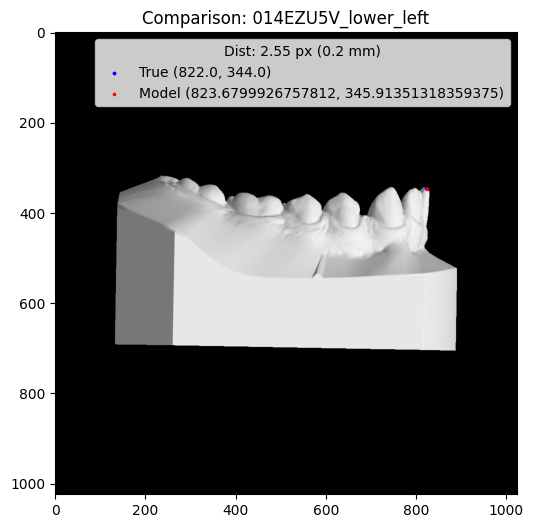

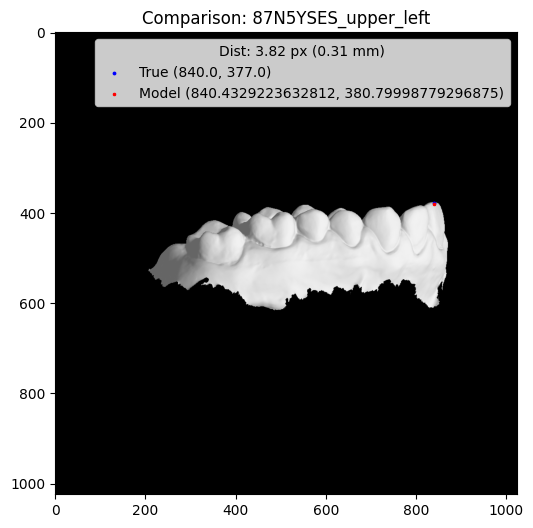

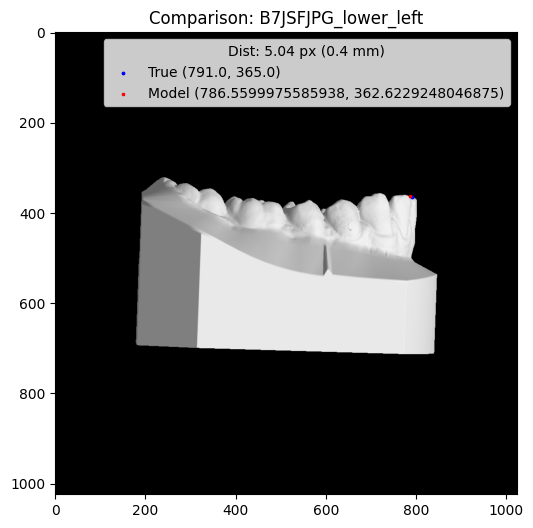

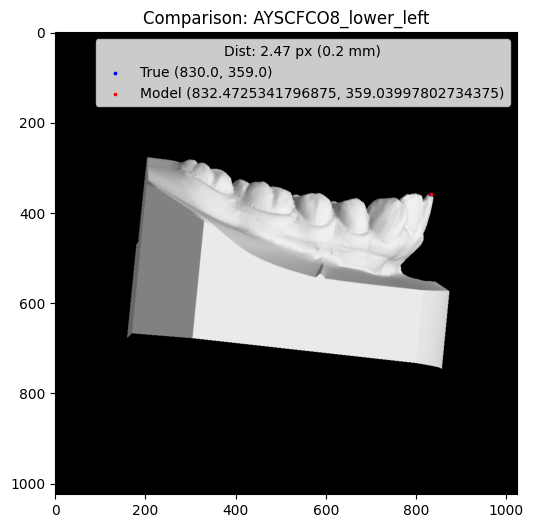

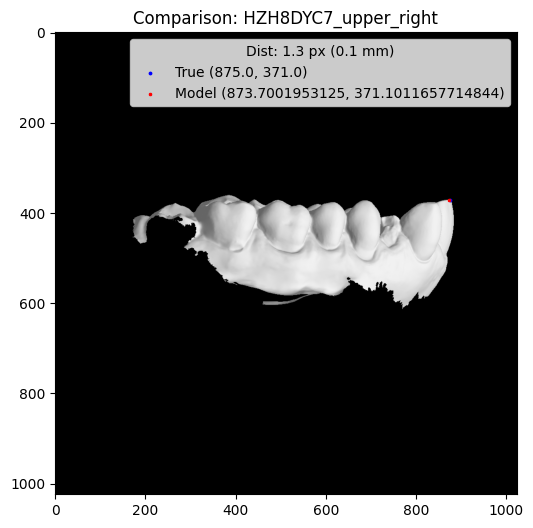

...

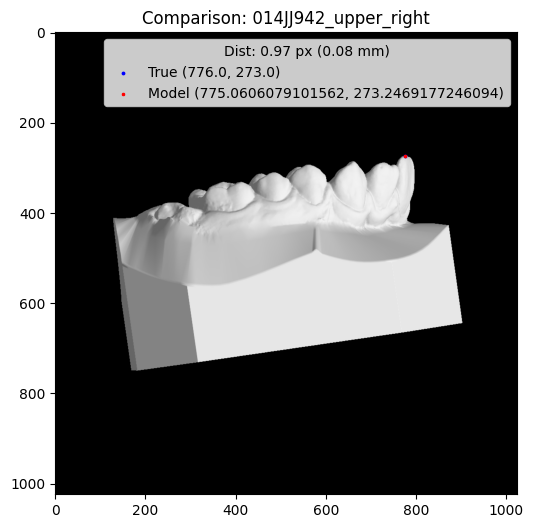

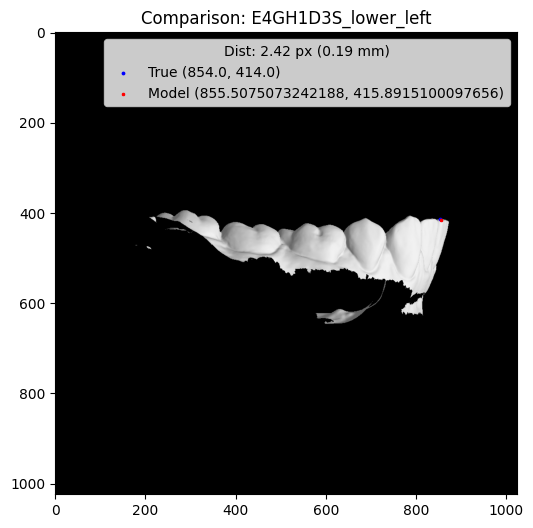

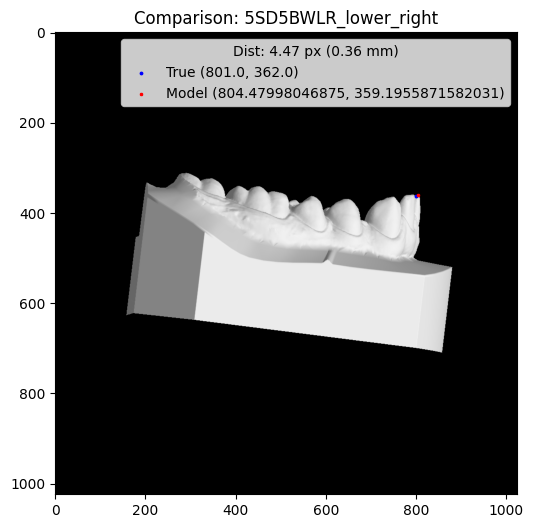

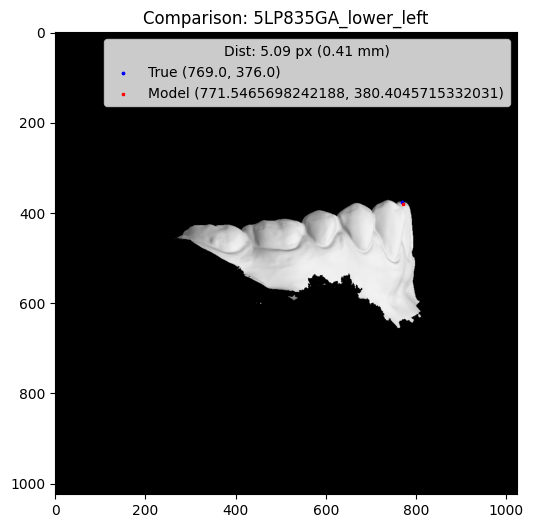

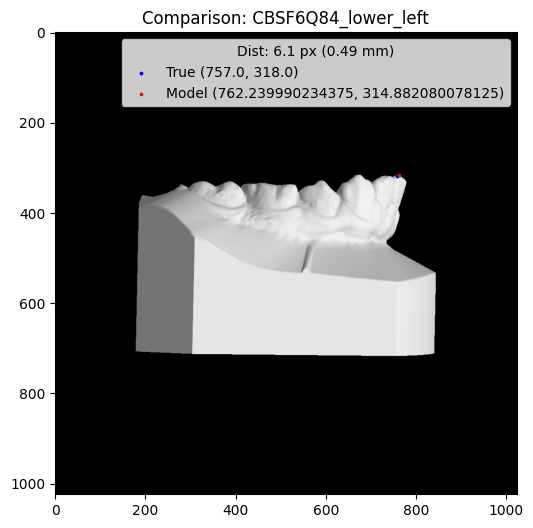

✅ Final results saved to: final_results_with_distance.csv


In [ ]:
import csv
import math
import matplotlib.pyplot as plt
# File paths
labels_file = "Dataprojekt/Data/Clean Data/Overbite Data/Updated_Labels.csv"
image_folder = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Test data"
output_csv = "final_results_with_distance.csv"

# Conversion
PIXEL_TO_MM = 0.08

# Load metadata and test dataset
dataset_dicts = DatasetCatalog.get("my_test_dataset")
metadata = MetadataCatalog.get("my_test_dataset")

# === LOAD GROUND TRUTH LABELS ===
ground_truth = {}
with open(labels_file, mode="r", newline="") as file:
    reader = csv.reader(file)
    next(reader)  # Skip header
    for row in reader:
        filename, x, y = [col.strip() for col in row]
        filename = os.path.splitext(filename)[0]  # remove extension
        ground_truth[filename] = (float(x), float(y))

# === MAIN LOOP: Predict, Match, Save, Visualize ===
rows = [["Filename", "X_True", "Y_True", "X_Model", "Y_Model", "Euc_dist", "mm_Dist"]]

for sample in dataset_dicts:
    img_path = sample["file_name"]
    filename = os.path.splitext(os.path.basename(img_path))[0]

    if filename not in ground_truth:
        print(f"⚠️ No ground truth for: {filename}")
        continue

    # Read image and run prediction
    img = cv2.imread(img_path)
    outputs = predictor(img)

    instances = outputs["instances"].to("cpu")
    if not instances.has("pred_keypoints"):
        print(f"❌ No keypoints found in: {filename}")
        continue

    keypoints = instances.pred_keypoints
    if len(keypoints) == 0:
        print(f"⚠️ Empty keypoint list in: {filename}")
        continue

    # Assume first instance
    pred_x, pred_y, _ = keypoints[0][0].tolist()
    true_x, true_y = ground_truth[filename]

    # Distance
    euc_dist = round(math.sqrt((true_x - pred_x) ** 2 + (true_y - pred_y) ** 2), 2)
    mm_dist = round(euc_dist * PIXEL_TO_MM, 2)

    # Save to CSV row
    rows.append([filename, true_x, true_y, pred_x, pred_y, euc_dist, mm_dist])

    # === VISUALIZE ===
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6, 6))
    plt.imshow(img_rgb)
    plt.scatter(true_x, true_y, color="blue", marker="o", s=3, label=f"True ({true_x}, {true_y})")
    plt.scatter(pred_x, pred_y, color="red", marker="x", s=3, label=f"Model ({pred_x}, {pred_y})")
    plt.legend(title=f"Dist: {euc_dist} px ({mm_dist} mm)")
    plt.title(f"Comparison: {filename}")
    plt.show()

# === SAVE FINAL CSV ===
with open(output_csv, mode="w", newline="") as file:
    writer = csv.writer(file)
    writer.writerows(rows)

print(f"✅ Final results saved to: {output_csv}")

# Ekstra test

📉 Excluding outliers > 40.0 mm. Showing 299 entries.


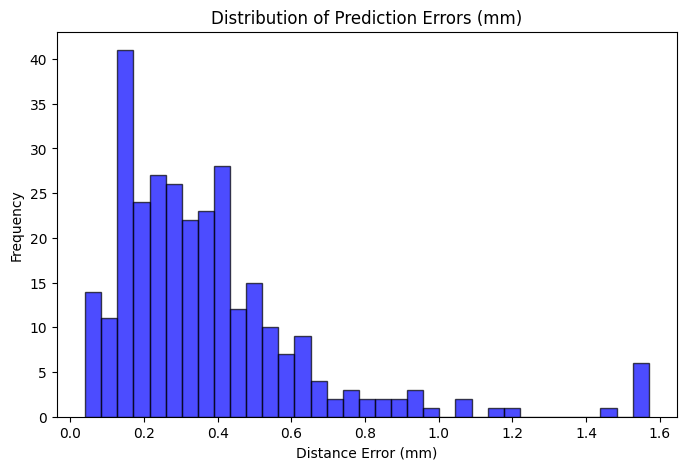

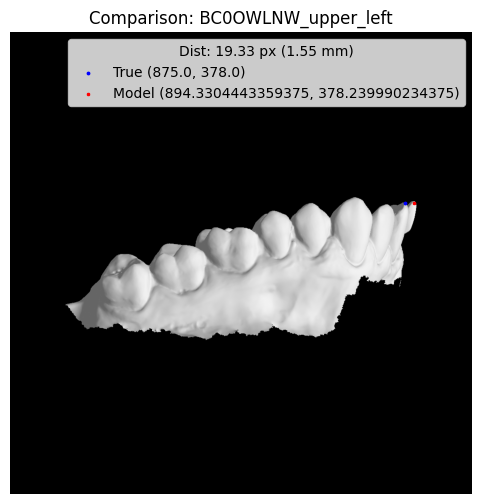

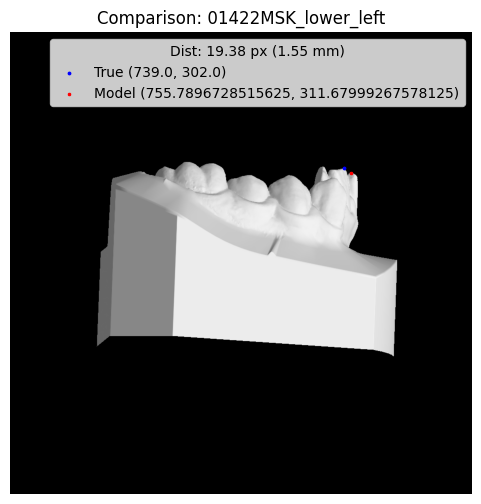

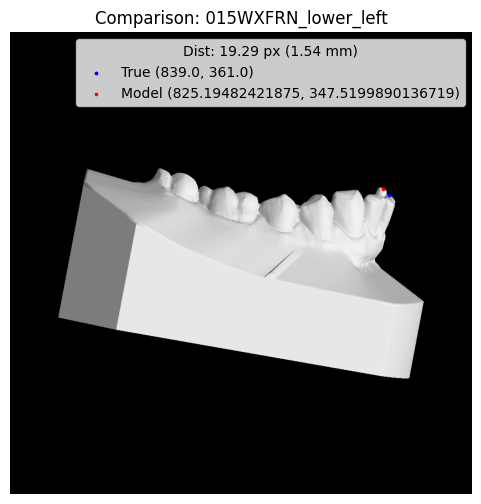

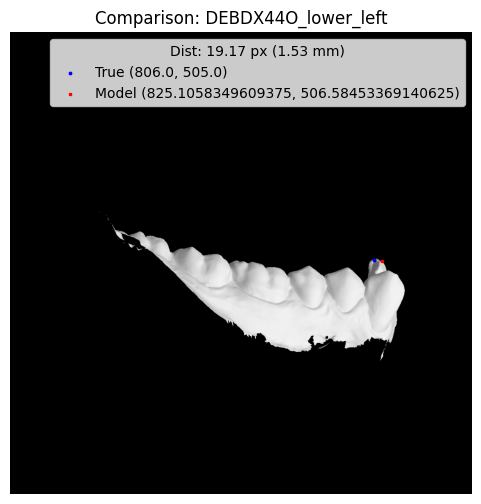

...

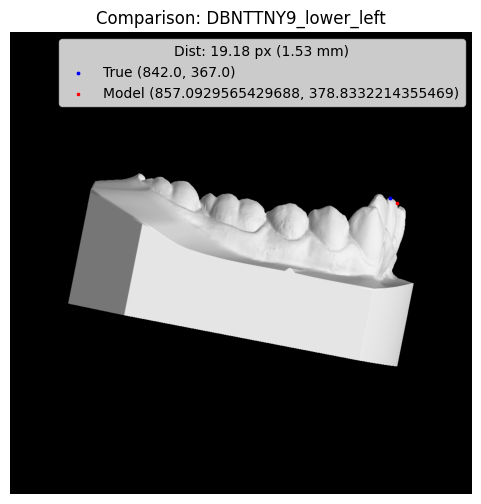

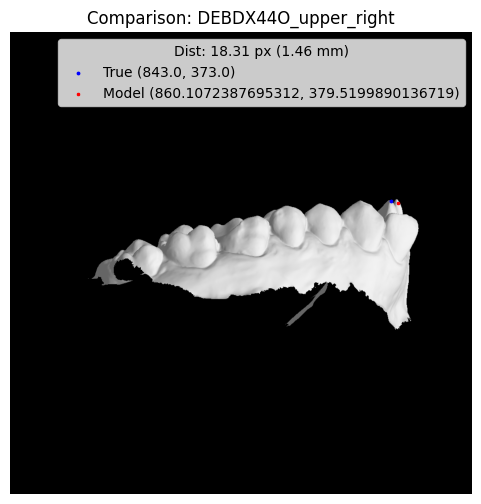

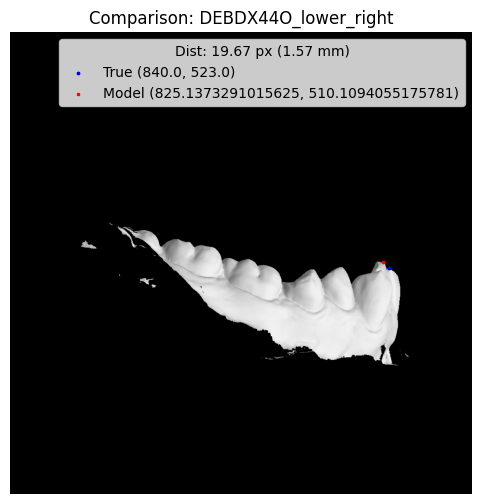

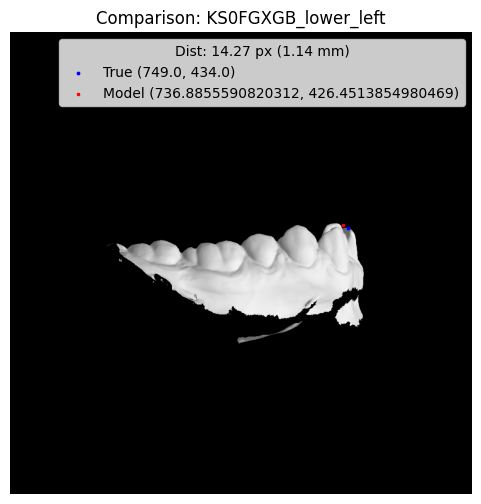

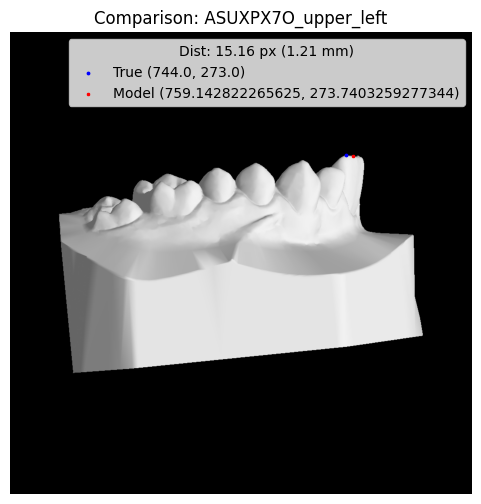

In [ ]:
import csv
import cv2
import matplotlib.pyplot as plt
import os

# === CONFIGURATION ===
matched_predictions_file = "final_results_with_distance.csv"
image_folder = "Dataprojekt/Data/Clean Data/Overbite Data/Annotated Test data"
error_threshold_mm = 1.0
PIXEL_TO_MM = 0.08  # In case you want to reverse-calculate
image_extension = ".png"  # Change to .jpg if needed

# === LOAD DATA FROM CSV ===
distances_mm = []
high_error_rows = []

with open(matched_predictions_file, mode="r", newline="") as file:
    reader = csv.reader(file)
    next(reader)  # Skip header row 1
    next(reader)  # Skip header row 2

    for row in reader:
        filename, true_x, true_y, pred_x, pred_y, euc_dist, mm_dist = row
        mm_dist = float(mm_dist)
        distances_mm.append(mm_dist)

        if mm_dist > error_threshold_mm:
            high_error_rows.append({
                "filename": filename,
                "true_x": float(true_x),
                "true_y": float(true_y),
                "pred_x": float(pred_x),
                "pred_y": float(pred_y),
                "euc_dist": float(euc_dist),
                "mm_dist": mm_dist
            })

# === CONFIGURATION ===
exclude_outliers = True
max_error_for_histogram = 40.0  # mm – only relevant if exclude_outliers is True


# === PLOT HISTOGRAM ===
if exclude_outliers:
    distances_for_hist = [d for d in distances_mm if d <= max_error_for_histogram]
    print(f"📉 Excluding outliers > {max_error_for_histogram} mm. Showing {len(distances_for_hist)} entries.")
else:
    distances_for_hist = distances_mm
    print(f"📊 Showing all {len(distances_mm)} entries in histogram.")

plt.figure(figsize=(8, 5))
plt.hist(distances_for_hist, bins=35, color="blue", edgecolor="black", alpha=0.7)
plt.xlabel("Distance Error (mm)")
plt.ylabel("Frequency")
plt.title("Distribution of Prediction Errors (mm)")
plt.show()

# === DISPLAY HIGH-ERROR IMAGES ===
for row in high_error_rows:
    filename = row["filename"]
    img_path = os.path.join(image_folder, filename + image_extension)

    if not os.path.exists(img_path):
        print(f"❌ Image not found: {img_path}")
        continue

    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(6, 6))
    plt.imshow(img_rgb)
    plt.scatter(row["true_x"], row["true_y"], color="blue", marker="o", s=3, label=f"True ({row['true_x']}, {row['true_y']})")
    plt.scatter(row["pred_x"], row["pred_y"], color="red", marker="x", s=3, label=f"Model ({row['pred_x']}, {row['pred_y']})")
    plt.legend(title=f"Dist: {row['euc_dist']} px ({row['mm_dist']} mm)")
    plt.title(f"Comparison: {filename}")
    plt.axis('off')
    plt.show()
